In [1]:
import numpy as np
from scipy.io import loadmat
from scipy.interpolate import griddata
import matplotlib.pyplot as plt
import cv2

**2. Demosaicing**

In [2]:
# Loading the bayer1 mat which is a dictionary
bayer1 = loadmat('Copy of bayer1.mat')
#print(bayer1)

# printing all the keys and values of the dictionary
for keys, values in bayer1.items():
    print(f"Key: {keys},\n Value: {values}")

bayer1_pattern = bayer1["bayer1"]
# print(bayer1_pattern)

Key: __header__,
 Value: b'MATLAB 5.0 MAT-file, Platform: GLNXA64, Created on: Tue Sep 13 18:22:04 2016'
Key: __version__,
 Value: 1.0
Key: __globals__,
 Value: []
Key: bayer1,
 Value: [[1 2 1 ... 2 1 2]
 [2 3 2 ... 3 2 3]
 [1 2 1 ... 2 1 2]
 ...
 [2 3 2 ... 3 2 3]
 [1 2 1 ... 2 1 2]
 [2 3 2 ... 3 2 3]]


In [3]:
# loading the RawImage1
raw_img1_data = loadmat(r'Copy of RawImage1.mat')
# print(raw_img1_data)

for keys, values in raw_img1_data.items():
    print(f"Key: {keys}, Value: \n{values}")

# printing the image matrix alone
raw_img1 = raw_img1_data["RawImage1"]
print(f"Image:\n{raw_img1}")
print(f"{raw_img1.shape}")

Key: __header__, Value: 
b'MATLAB 5.0 MAT-file, Platform: GLNXA64, Created on: Tue Sep 13 18:18:13 2016'
Key: __version__, Value: 
1.0
Key: __globals__, Value: 
[]
Key: RawImage1, Value: 
[[116 197 128 ...  54   6   9]
 [194 146 179 ...  46  46   0]
 [112 187 118 ...  24  18  26]
 ...
 [ 58  39  51 ...  15  35  26]
 [ 32  59  32 ...  14  15  30]
 [ 68  26  60 ...   9   7   0]]
Image:
[[116 197 128 ...  54   6   9]
 [194 146 179 ...  46  46   0]
 [112 187 118 ...  24  18  26]
 ...
 [ 58  39  51 ...  15  35  26]
 [ 32  59  32 ...  14  15  30]
 [ 68  26  60 ...   9   7   0]]
(1128, 2048)


(<matplotlib.image.AxesImage at 0x1dedb0a6890>,
 (-0.5, 2047.5, 1127.5, -0.5),
 Text(0.5, 1.0, 'RawImage1'))

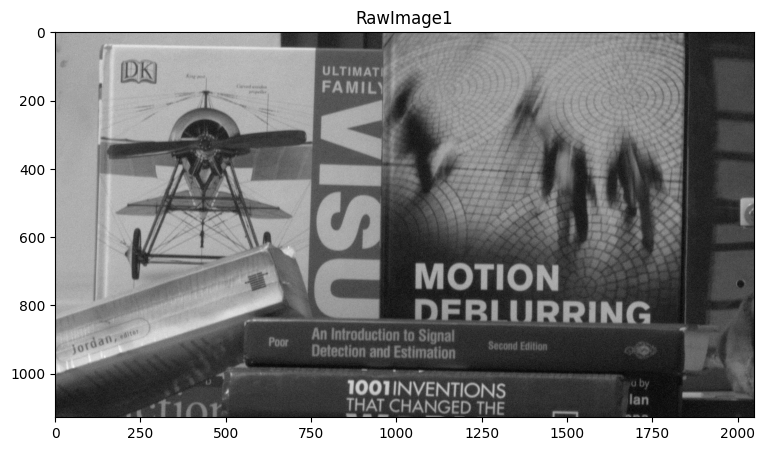

In [4]:
plt.figure(figsize=(10,5))
plt.imshow(raw_img1, cmap="gray"), plt.axis("on"), plt.title("RawImage1")

In [5]:
def griddata_demosaic(raw, cfa, method):
    h, w = raw.shape
    x, y = np.mgrid[0:h, 0:w]
    # print(x.shape,y.shape, raw.shape)

    # Get the position of r,g,b from cfa when cfa values = 1,2,3 respectively
    r_pos = np.where(cfa == 1)
    g_pos = np.where(cfa == 2)
    b_pos = np.where(cfa == 3)

    # Take a new matrix and fill it with the pixel values of raw image
    r_values = raw[r_pos]
    g_values = raw[g_pos]
    b_values = raw[b_pos]
   
   # interpolate using griddata
    r_channel = griddata(r_pos, r_values, (x, y), method=method, fill_value=0)
    g_channel = griddata(g_pos, g_values, (x, y), method=method, fill_value=0)
    b_channel = griddata(b_pos, b_values, (x, y), method=method, fill_value=0)
    rgb_image = np.stack((r_channel, g_channel, b_channel), axis=-1)
    return rgb_image

In [6]:
# 2a) demosaicing using griddata function and linear interpolation
img1_linear = griddata_demosaic(raw_img1, bayer1_pattern, method='linear')
img1_linear = img1_linear.astype(np.uint8)

# 2b) demosaicing using griddata function and bicubic interpolation
img1_cubic = griddata_demosaic(raw_img1, bayer1_pattern, method='cubic')
img1_cubic = img1_cubic.astype(np.uint8)

# 2c) demosaicing using OpenCV built-in function
img_func = cv2.cvtColor(raw_img1, cv2.COLOR_BAYER_RG2RGB)

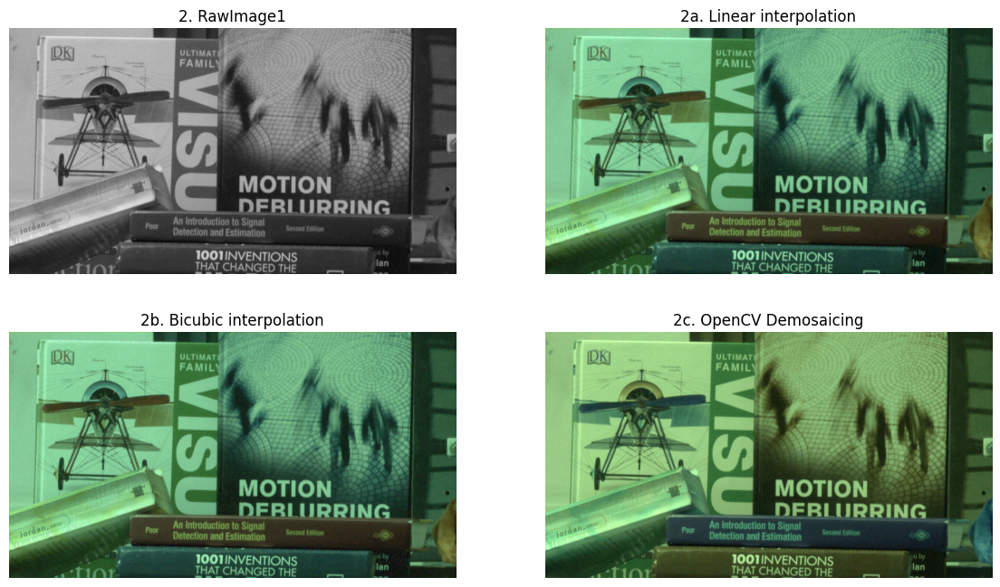

In [7]:
# Displaying the results
plt.figure(figsize=(14,8))
plt.subplot(2,2,1),plt.imshow(raw_img1, cmap="gray"), plt.axis("off"), plt.title("2. RawImage1")
plt.subplot(2,2,2),plt.imshow(img1_linear), plt.axis("off"), plt.title("2a. Linear interpolation")
plt.subplot(2,2,3),plt.imshow(img1_cubic), plt.axis("off"), plt.title("2b. Bicubic interpolation")
plt.subplot(2,2,4),plt.imshow(img_func), plt.axis("off"), plt.title("2c. OpenCV Demosaicing")
plt.show()

**2d)** Assumptions made while interpolating: The colors in natural images typically vary smoothly, meaning that the color values (R, G, B) at neighboring pixels does not differ drastically. This allows interpolation to estimate missing color values by averaging or interpolating between adjacent pixel values. This assumption fails in regions with sharp edges, high-frequency details, or abrupt color transitions (e.g., boundaries between objects, fine textures, or areas with detailed patterns). In such cases, the interpolation might blur the edges or introduce artifacts like color fringing or false colors.

In [8]:
# 2e) demosiacing kodim data
# loading the RawImage1
raw_data = loadmat('Copy of kodim19.mat')
# print(raw_data)
# printing the image matrix alone
kodim_img = raw_data["raw"]

kodim_cfa_data = loadmat('Copy of kodim_cfa.mat')
# print(kodim_cfa_data)
kodim_cfa = kodim_cfa_data["cfa"]

kondim_cubic = griddata_demosaic(kodim_img, kodim_cfa, method='cubic')
kondim_cubic = kondim_cubic.astype(np.uint8)

In [9]:
# 2f) Converting to YCrCb and applying median blur
yCrCb = cv2.cvtColor(kondim_cubic, cv2.COLOR_RGB2YCrCb)
y,cr,cb = cv2.split(yCrCb)

median_filtered_cr = cv2.medianBlur(cr, 7)
median_filtered_cb = cv2.medianBlur(cb, 7)

median_filtered_ycrcb = cv2.merge((y, median_filtered_cr, median_filtered_cb))
median_filtered_rgb = cv2.cvtColor( median_filtered_ycrcb, cv2.COLOR_YCrCb2RGB )

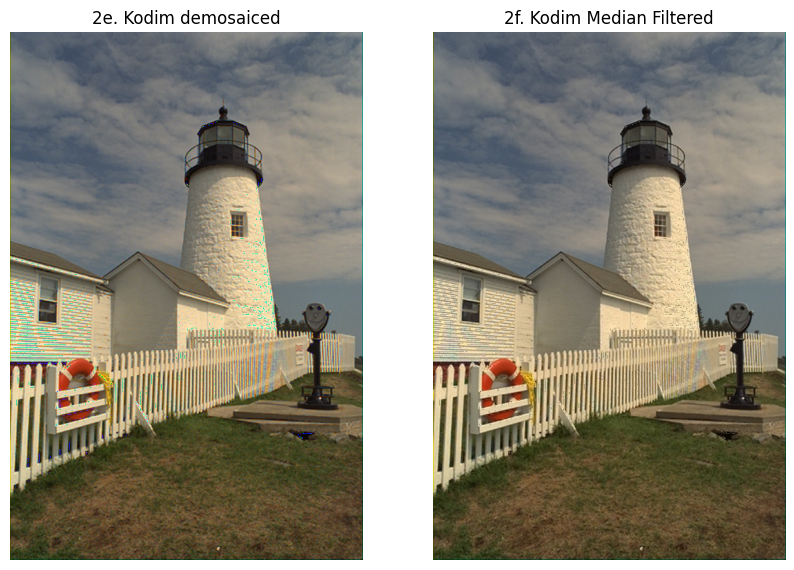

In [10]:
plt.figure(figsize=(10,15))
plt.subplot(1,2,1),plt.imshow(kondim_cubic), plt.axis("off"), plt.title("2e. Kodim demosaiced")
plt.subplot(1,2,2),plt.imshow(median_filtered_rgb), plt.axis("off"), plt.title("2f. Kodim Median Filtered")
plt.show()

**2g)** On comparing the results of 2e and 2f and the original data, 2e has colour artifacts seen near the window of the house, lighthouse and on the fence. The filtered image of 2f has less artifacts seen near the window and lighthouse some artifact clearly seen on the fence. 

**3.White Balancing and Tone Mapping**

In [11]:
# Reading the bayer pattern
bayer2 = loadmat('Copy of bayer2.mat')
bayer2_pattern = bayer2["bayer2"]

#reading the raw image
raw_img2_data = loadmat(r'Copy of RawImage2.mat')
raw_img2 = raw_img2_data["RawImage2"]

#  demosaicing using griddata function and linear interpolation
img2_linear = griddata_demosaic(raw_img2, bayer2_pattern, method='linear')
img2_linear = img2_linear.astype(np.uint8)

#  demosaicing using griddata function and bicubic interpolation
img2_cubic = griddata_demosaic(raw_img2, bayer2_pattern, method='cubic')
img2_cubic = img2_cubic.astype(np.uint8)

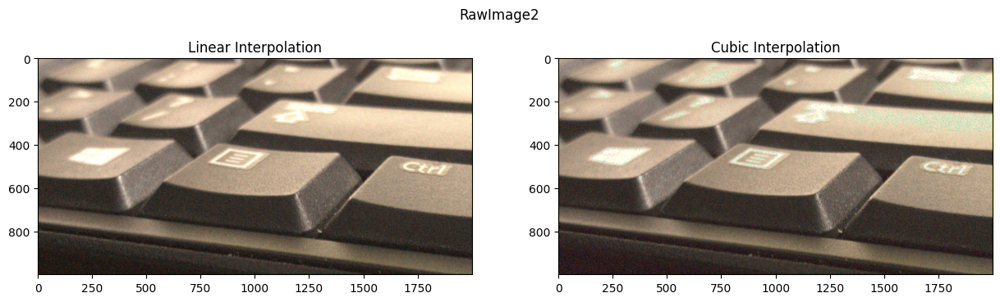

In [12]:
plt.figure(figsize=(15,4))
plt.subplot(121),plt.imshow(img2_linear), plt.title("Linear Interpolation"), plt.axis("on")
plt.subplot(122),plt.imshow(img2_cubic), plt.title("Cubic Interpolation"), plt.axis("on")
plt.suptitle("RawImage2")
plt.show()

In [13]:
bayer3 = loadmat('Copy of bayer3.mat')
bayer3_pattern = bayer3["bayer3"]

#reading the raw image
raw_img3_data = loadmat(r'Copy of RawImage3.mat')
raw_img3 = raw_img3_data["RawImage3"]

#  demosaicing using griddata function and linear interpolation
img3_linear = griddata_demosaic(raw_img3, bayer3_pattern, method='linear')
img3_linear = img3_linear.astype(np.uint8)

#  demosaicing using griddata function and bicubic interpolation
img3_cubic = griddata_demosaic(raw_img3, bayer3_pattern, method='cubic')
img3_cubic = img3_cubic.astype(np.uint8)

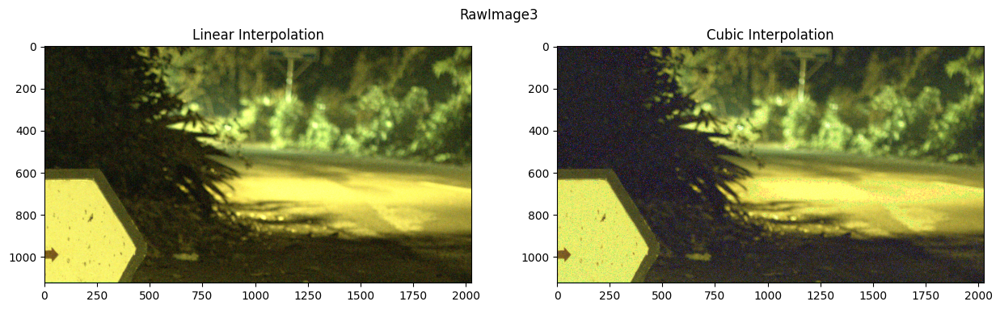

In [14]:
plt.figure(figsize=(15,4))
plt.subplot(121),plt.imshow(img3_linear), plt.title("Linear Interpolation"), plt.axis("on")
plt.subplot(122),plt.imshow(img3_cubic), plt.title("Cubic Interpolation"), plt.axis("on")
plt.suptitle("RawImage3")
plt.show()

In [15]:
# 3a) assuming average scene to be gray
def average_wb(img):
    r,g,b = cv2.split(img)

    r_avg = np.mean(r)
    g_avg = np.mean(g)
    b_avg = np.mean(b)

    avg_gray = (r_avg + g_avg + b_avg) / 3

    r_scale = avg_gray / r_avg
    g_scale = avg_gray / g_avg
    b_scale = avg_gray / b_avg

    r = np.clip((r_scale * r),0,255).astype(np.uint8)
    g = np.clip((g_scale * g),0,255).astype(np.uint8)
    b = np.clip((b_scale * b),0,255).astype(np.uint8)

    return cv2.merge((r,g,b))

# 3b) assuming the brightest pixel is the specular highlight
def specular_wb(img, x, y):
    r,g,b = cv2.split(img)

    r_val, g_val, b_val = img[y,x] 

    r_scale = 255 / r_val
    g_scale = 255 / g_val
    b_scale = 255 / b_val

    r = np.clip((r_scale * r),0,255).astype(np.uint8)
    g = np.clip((g_scale * g),0,255).astype(np.uint8)
    b = np.clip((b_scale * b),0,255).astype(np.uint8)

    return cv2.merge((r,g,b))

# 3c) Assuming some parts are neutral
def neutral_wb(img, x, y):
    r,g,b = cv2.split(img)

    r_val, g_val, b_val = img[y,x] # np takes (rows, cols)

    neutral_val = (r_val + g_val + b_val)/3

    r_scale = neutral_val / r_val
    g_scale = neutral_val / g_val
    b_scale = neutral_val / b_val

    r = np.clip((r_scale * r),0,255).astype(np.uint8)
    g = np.clip((g_scale * g),0,255).astype(np.uint8)
    b = np.clip((b_scale * b),0,255).astype(np.uint8)

    return cv2.merge((r,g,b))

In [16]:
# Whitebalancing RawImage1 linear
wb_img1_gray_linear = average_wb(img1_linear)
wb_img1_spec_linear = specular_wb(img1_linear, 830, 814)
wb_img1_neut_linear = neutral_wb(img1_linear, 2000, 435)

# Whitebalancing RawImage1 Cubic
wb_img1_gray_cubic = average_wb(img1_cubic)
wb_img1_spec_cubic = specular_wb(img1_cubic, 830, 814)
wb_img1_neut_cubic = neutral_wb(img1_cubic, 2000, 435)

img1_wb_res = [
    img1_linear, img1_cubic, 
    wb_img1_gray_linear, wb_img1_gray_cubic,
    wb_img1_spec_linear, wb_img1_spec_cubic,
    wb_img1_neut_linear, wb_img1_neut_cubic
]

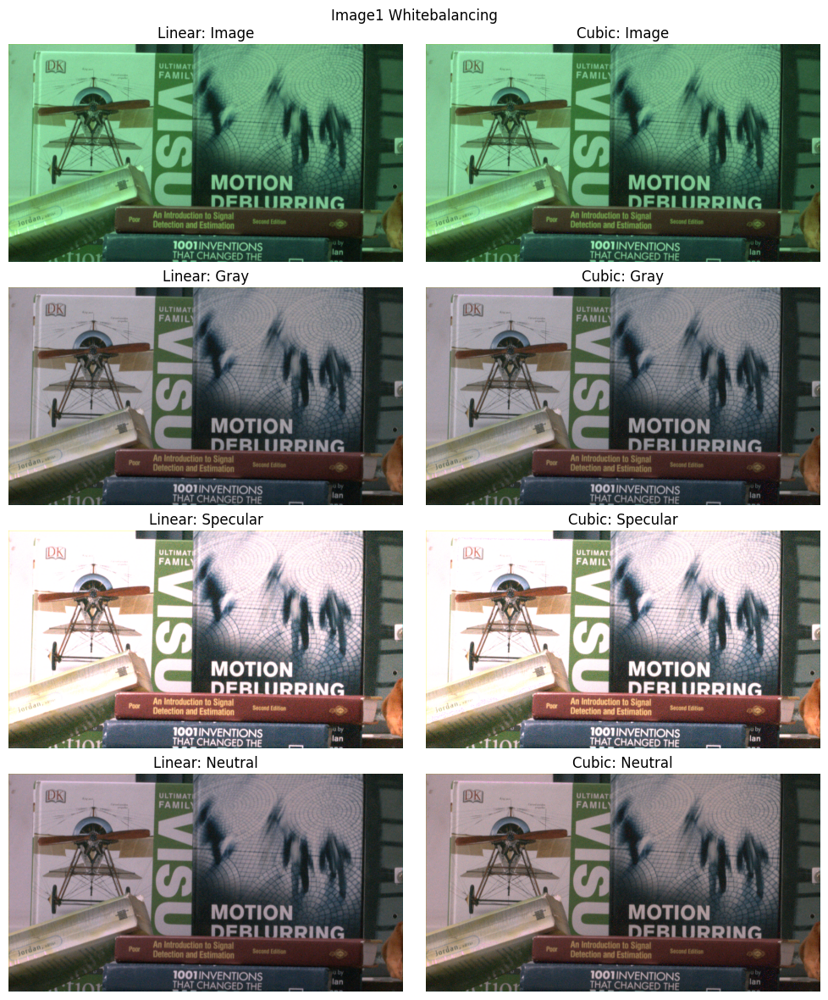

In [17]:
titles = ['Image', 'Gray', 'Specular', 'Neutral']
plt.figure(figsize=(10, 12))

for i in range(4):
    plt.subplot(4, 2, 2 * i + 1)  
    plt.imshow(img1_wb_res[2 * i]), plt.axis("off")
    plt.title(f"Linear: {titles[i]}")
    
    plt.subplot(4, 2, 2 * i + 2)  
    plt.imshow(img1_wb_res[2 * i + 1]), plt.axis("off")
    plt.title(f"Cubic: {titles[i]}")
plt.suptitle("Image1 Whitebalancing")
plt.tight_layout()
plt.show()

In [18]:
# Whitebalancing RawImage2 - Linear
wb_img2_gray_linear = average_wb(img2_linear)
wb_img2_spec_linear = specular_wb(img2_linear, 1165, 280)
wb_img2_neut_linear = neutral_wb(img2_linear, 445, 715)

# Whitebalancing RawImage2 - cubic
wb_img2_gray_cubic = average_wb(img2_cubic)
wb_img2_spec_cubic = specular_wb(img2_cubic, 1165, 280)
wb_img2_neut_cubic = neutral_wb(img2_cubic, 445, 715)

img2_wb_res = [
    img2_linear, img2_cubic, 
    wb_img2_gray_linear, wb_img2_gray_cubic,
    wb_img2_spec_linear, wb_img2_spec_cubic,
    wb_img2_neut_linear, wb_img2_neut_cubic
]

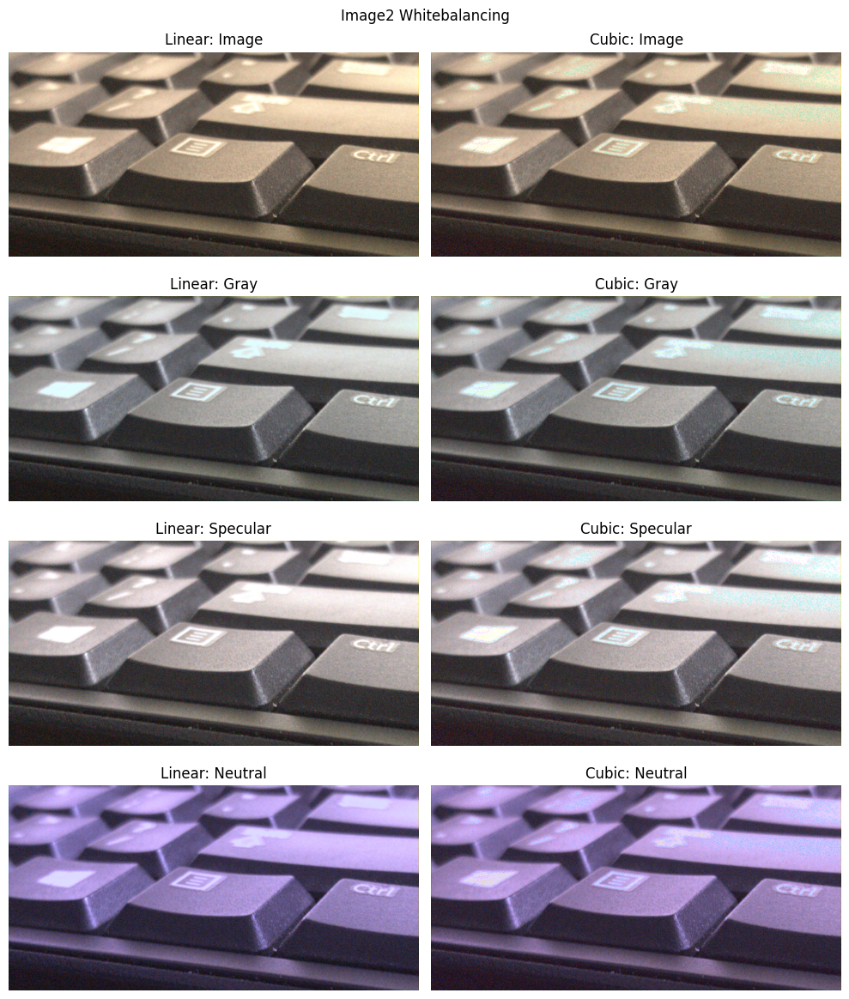

In [19]:
plt.figure(figsize=(10, 12))

for i in range(4):
    plt.subplot(4, 2, 2 * i + 1)  
    plt.imshow(img2_wb_res[2 * i]), plt.axis("off")
    plt.title(f"Linear: {titles[i]}")
    
    plt.subplot(4, 2, 2 * i + 2)  
    plt.imshow(img2_wb_res[2 * i + 1]), plt.axis("off")
    plt.title(f"Cubic: {titles[i]}")
plt.suptitle("Image2 Whitebalancing")
plt.tight_layout()
plt.show()

In [20]:
# Whitebalancing RawImage3 - Linear
wb_img3_gray_linear = average_wb(img3_linear)
wb_img3_spec_linear = specular_wb(img3_linear, 175,675)
wb_img3_neut_linear = neutral_wb(img3_linear, 1550, 565)

# Whitebalancing RawImage3 - cubic
wb_img3_gray_cubic = average_wb(img3_cubic)
wb_img3_spec_cubic = specular_wb(img3_cubic, 175,675)
wb_img3_neut_cubic = neutral_wb(img3_cubic, 1550, 565)

img3_wb_res = [
    img3_linear, img3_cubic, 
    wb_img3_gray_linear, wb_img3_gray_cubic,
    wb_img3_spec_linear, wb_img3_spec_cubic,
    wb_img3_neut_linear, wb_img3_neut_cubic
]

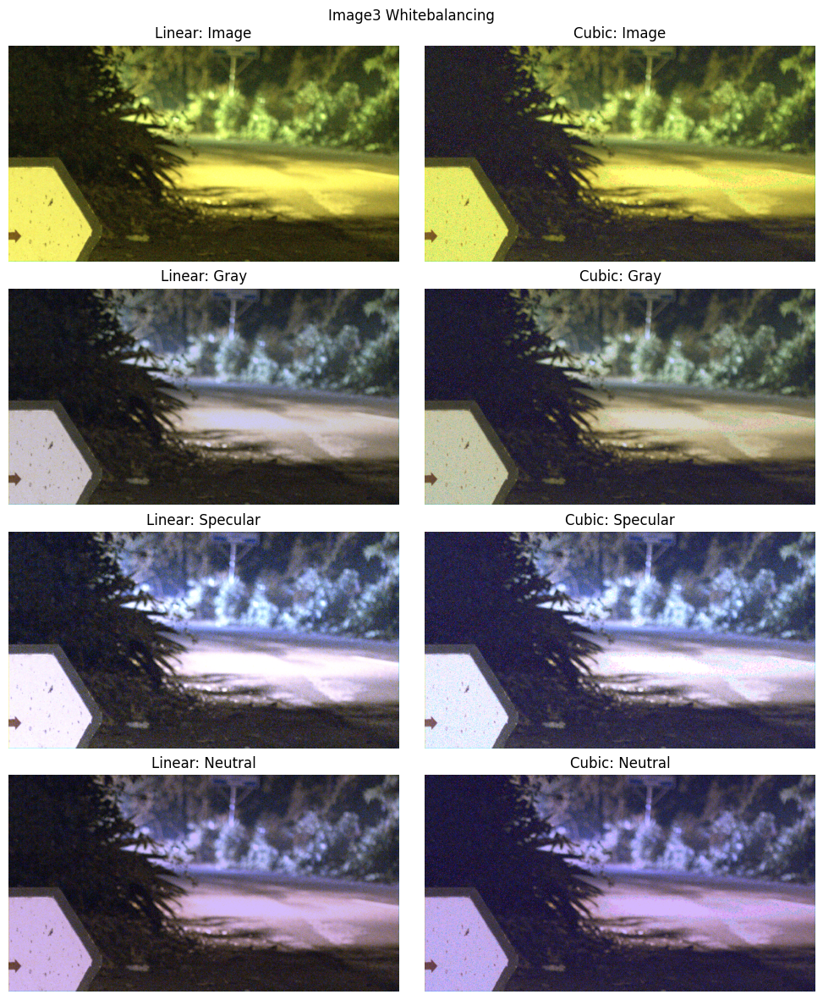

In [21]:
plt.figure(figsize=(10, 12))

for i in range(4):
    plt.subplot(4, 2, 2 * i + 1)  
    plt.imshow(img3_wb_res[2 * i]), plt.axis("off")
    plt.title(f"Linear: {titles[i]}")
    
    plt.subplot(4, 2, 2 * i + 2)  
    plt.imshow(img3_wb_res[2 * i + 1]), plt.axis("off")
    plt.title(f"Cubic: {titles[i]}")
plt.suptitle("Image3 Whitebalancing")
plt.tight_layout()
plt.show()

In [22]:
# 3d) Tone Mapping
# i) Histogray Equalization
def hist_eq_channel(channel):
    # Computing the histogram of the channel
    hist, bins = np.histogram(channel.flatten(), bins=256, range=[0, 256])
    cdf = hist.cumsum()
    
    # Normalizing the CDF
    cdf_normalized = (cdf / cdf[-1])*255
    
    # Interpolating the values of the CDF to find new pixel values. If this is not done, we get discrete histogram
    channel_equalized = np.interp(channel.flatten(), bins[:-1], cdf_normalized)
    
    return channel_equalized.reshape(channel.shape).astype(np.uint8)

def histogram_equalization(img):
    r,g,b = cv2.split(img)
    
    # Equalizing each channel separately
    r_eq = hist_eq_channel(r)
    g_eq = hist_eq_channel(g)
    b_eq = hist_eq_channel(b)
    
    equalized_image = np.stack([r_eq, g_eq, b_eq], axis=-1)
    
    return equalized_image

In [23]:
# Histogram Equalization of RawImage1 - linear and corresponding WB images
histeq_img1_linear = histogram_equalization(img1_linear)
histeq_gray1_linear = histogram_equalization(wb_img1_gray_linear)
histeq_spec1_linear = histogram_equalization(wb_img1_spec_linear)
histeq_neut1_linear = histogram_equalization(wb_img1_neut_linear)

# Histogram Equalization of RawImage1 - Cubic and corresponding WB images
histeq_img1_cubic = histogram_equalization(img1_cubic)
histeq_gray1_cubic = histogram_equalization(wb_img1_gray_cubic)
histeq_spec1_cubic = histogram_equalization(wb_img1_spec_cubic)
histeq_neut1_cubic = histogram_equalization(wb_img1_neut_cubic)

histeq_img1_res = [
    histeq_img1_linear, histeq_img1_cubic,
    histeq_gray1_linear, histeq_gray1_cubic,
    histeq_spec1_linear, histeq_spec1_cubic,
    histeq_neut1_linear, histeq_neut1_cubic
]

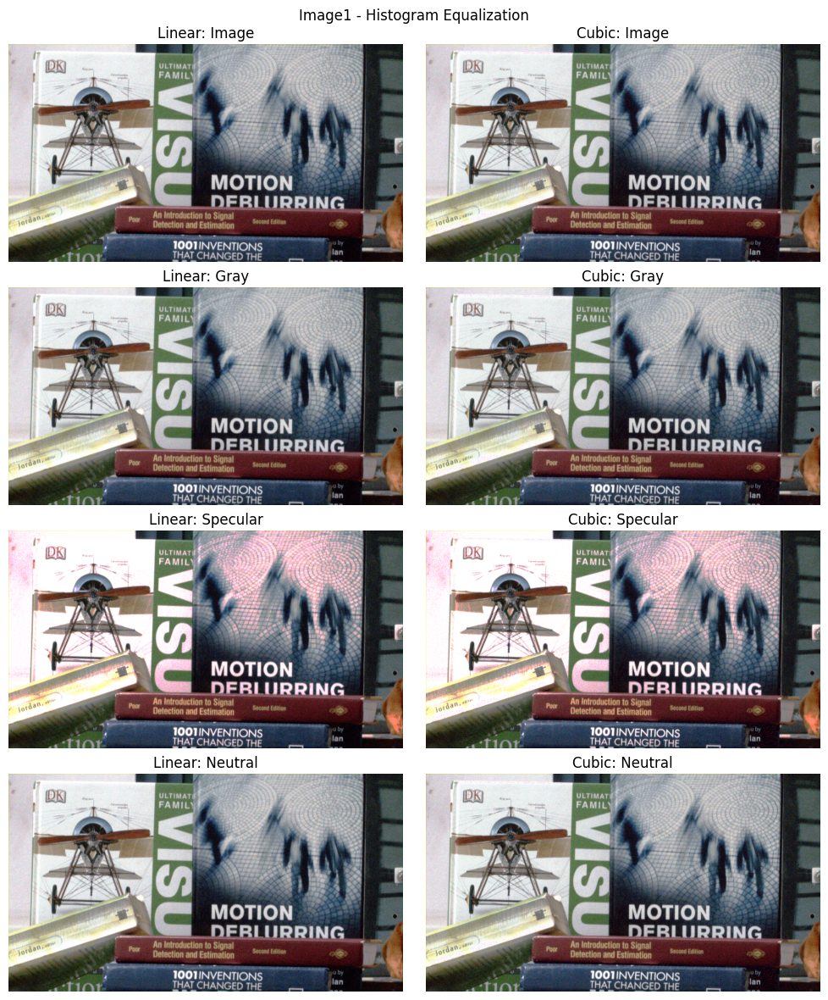

In [24]:
plt.figure(figsize=(10, 12))

for i in range(4):
    plt.subplot(4, 2, 2 * i + 1)  
    plt.imshow(histeq_img1_res[2 * i]), plt.axis("off")
    plt.title(f"Linear: {titles[i]}")
    
    plt.subplot(4, 2, 2 * i + 2)  
    plt.imshow(histeq_img1_res[2 * i + 1]), plt.axis("off")
    plt.title(f"Cubic: {titles[i]}")
plt.suptitle("Image1 - Histogram Equalization")
plt.tight_layout()
plt.show()

In [25]:
# Histogram Equalization of RawImage2 - linear and corresponding WB images
histeq_img2_linear = histogram_equalization(img2_linear)
histeq_gray2_linear = histogram_equalization(wb_img2_gray_linear)
histeq_spec2_linear = histogram_equalization(wb_img2_spec_linear)
histeq_neut2_linear = histogram_equalization(wb_img2_neut_linear)

# Histogram Equalization of RawImage2 - Cubic and corresponding WB images
histeq_img2_cubic = histogram_equalization(img2_cubic)
histeq_gray2_cubic = histogram_equalization(wb_img2_gray_cubic)
histeq_spec2_cubic = histogram_equalization(wb_img2_spec_cubic)
histeq_neut2_cubic = histogram_equalization(wb_img2_neut_cubic)

histeq_img2_res = [
    histeq_img2_linear, histeq_img2_cubic,
    histeq_gray2_linear, histeq_gray2_cubic,
    histeq_spec2_linear, histeq_spec2_cubic,
    histeq_neut2_linear, histeq_neut2_cubic
]

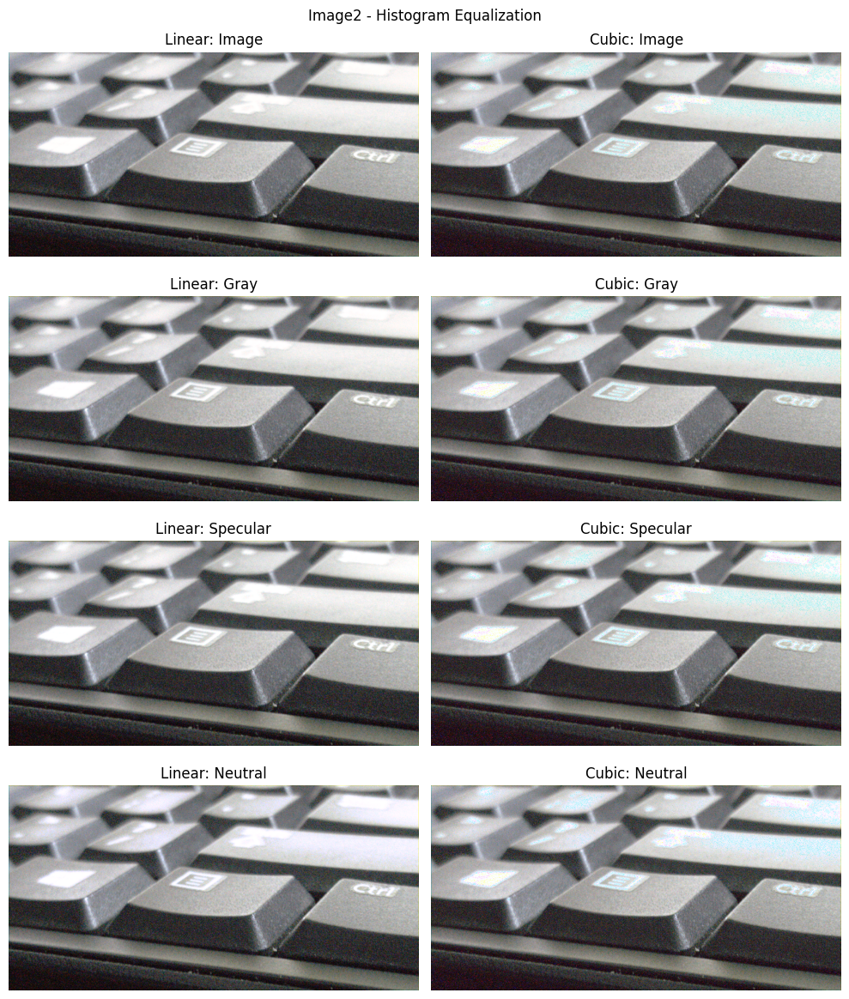

In [26]:
plt.figure(figsize=(10, 12))

for i in range(4):
    plt.subplot(4, 2, 2 * i + 1)  
    plt.imshow(histeq_img2_res[2 * i]), plt.axis("off")
    plt.title(f"Linear: {titles[i]}")
    
    plt.subplot(4, 2, 2 * i + 2)  
    plt.imshow(histeq_img2_res[2 * i + 1 ]), plt.axis("off")
    plt.title(f"Cubic: {titles[i]}")
plt.suptitle("Image2 - Histogram Equalization")
plt.tight_layout()
plt.show()

In [27]:
# Histogram Equalization of RawImage3 - linear and corresponding WB images
histeq_img3_linear = histogram_equalization(img3_linear)
histeq_gray3_linear = histogram_equalization(wb_img3_gray_linear)
histeq_spec3_linear = histogram_equalization(wb_img3_spec_linear)
histeq_neut3_linear = histogram_equalization(wb_img3_neut_linear)

# Histogram Equalization of RawImage3 - Cubic and corresponding WB images
histeq_img3_cubic = histogram_equalization(img3_cubic)
histeq_gray3_cubic = histogram_equalization(wb_img3_gray_cubic)
histeq_spec3_cubic = histogram_equalization(wb_img3_spec_cubic)
histeq_neut3_cubic = histogram_equalization(wb_img3_neut_cubic)

histeq_img3_res = [
    histeq_img3_linear, histeq_img3_cubic,
    histeq_gray3_linear, histeq_gray3_cubic,
    histeq_spec3_linear, histeq_spec3_cubic,
    histeq_neut3_linear, histeq_neut3_cubic
]

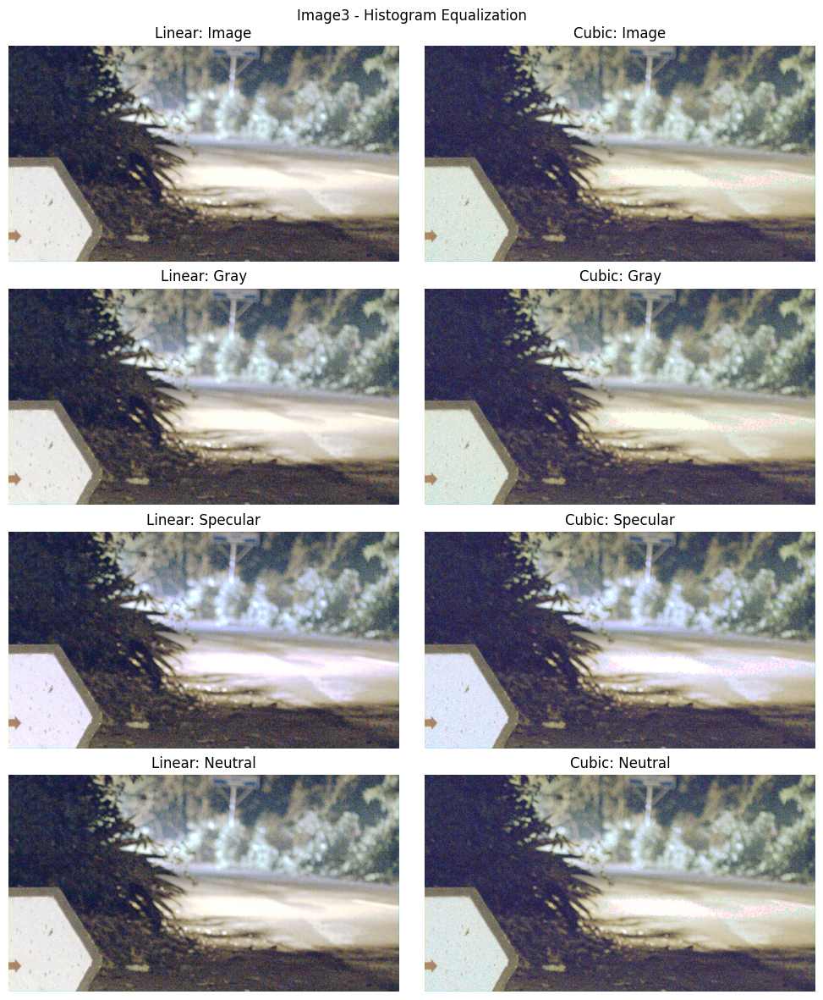

In [28]:
plt.figure(figsize=(10, 12))

for i in range(4):
    plt.subplot(4, 2, 2 * i + 1)  
    plt.imshow(histeq_img3_res[2 * i]), plt.axis("off")
    plt.title(f"Linear: {titles[i]}")
    
    plt.subplot(4, 2, 2 * i + 2)  
    plt.imshow(histeq_img3_res[2 * i + 1 ]), plt.axis("off")
    plt.title(f"Cubic: {titles[i]}")
plt.suptitle("Image3 - Histogram Equalization")
plt.tight_layout()
plt.show()

In [29]:
# 3d) Tonemapping
# ii) Gamma correction
def gamma_correction(img, gamma):
    norm_img = img / 255.0
    corrected_image = np.power(norm_img, gamma)
    corrected_image = (corrected_image * 255).astype(np.uint8)
    return corrected_image

def plot_gamma_corrected_imgs(img, gamma_vals, titles, suptitle):
    plt.figure(figsize=(12,10))
    num_img = len(img)
    num_gammas = len(gamma_vals)
    
    for i, (img_set, title_prefix) in enumerate(zip(img, titles)):
        for j, (img, gamma) in enumerate(zip(img_set, gamma_vals)):
            plt.subplot(num_img, num_gammas, i * num_gammas + j + 1)
            plt.imshow(img)
            plt.axis('off')
            plt.title(f"{title_prefix} Gamma {gamma}")

    plt.suptitle(f"{suptitle} interpolated - Gamma Correction")
    plt.tight_layout()
    plt.show()
gamma_values = [0.5, 0.7, 0.9]

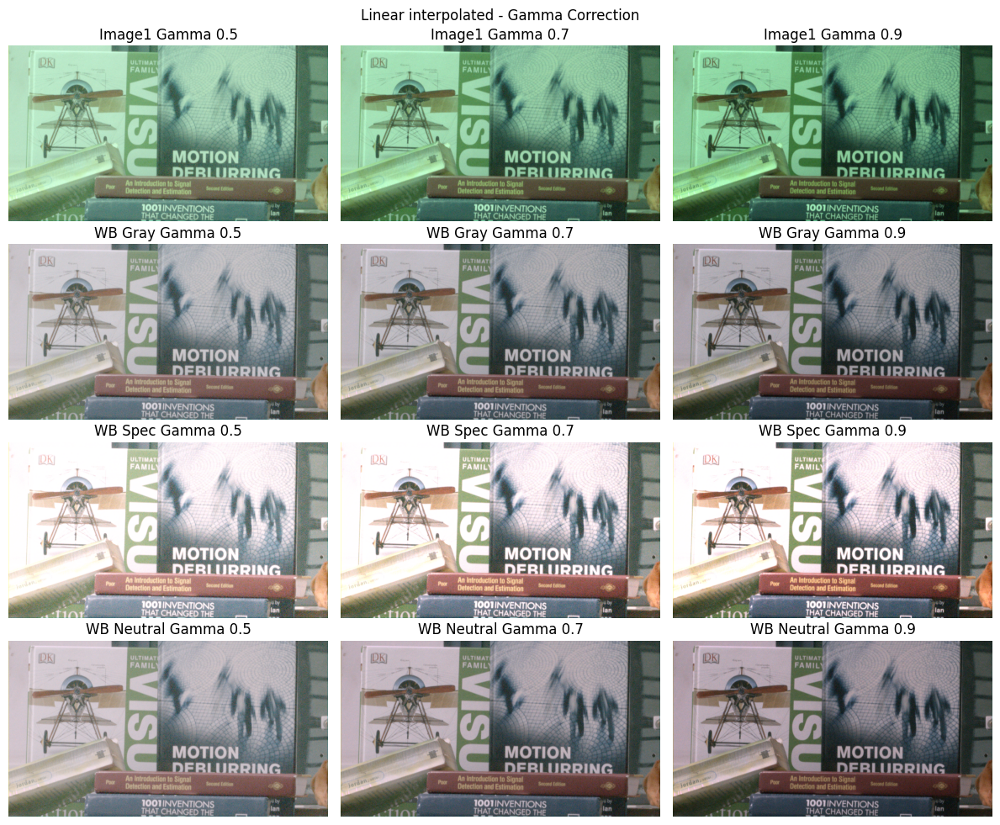

In [30]:
gamma_corrected_img1_linear = [[gamma_correction(img1_linear, 0.5), gamma_correction(img1_linear, 0.7), gamma_correction(img1_linear, 0.9)],
    [gamma_correction(wb_img1_gray_linear, 0.5), gamma_correction(wb_img1_gray_linear, 0.7), gamma_correction(wb_img1_gray_linear, 0.9)],
    [gamma_correction(wb_img1_spec_linear, 0.5), gamma_correction(wb_img1_spec_linear, 0.7), gamma_correction(wb_img1_spec_linear, 0.9)],
    [gamma_correction(wb_img1_neut_linear, 0.5), gamma_correction(wb_img1_neut_linear, 0.7), gamma_correction(wb_img1_neut_linear, 0.9)]]
titles = ["Image1", "WB Gray", "WB Spec", "WB Neutral"]
plot_gamma_corrected_imgs(gamma_corrected_img1_linear, gamma_values, titles, "Linear")

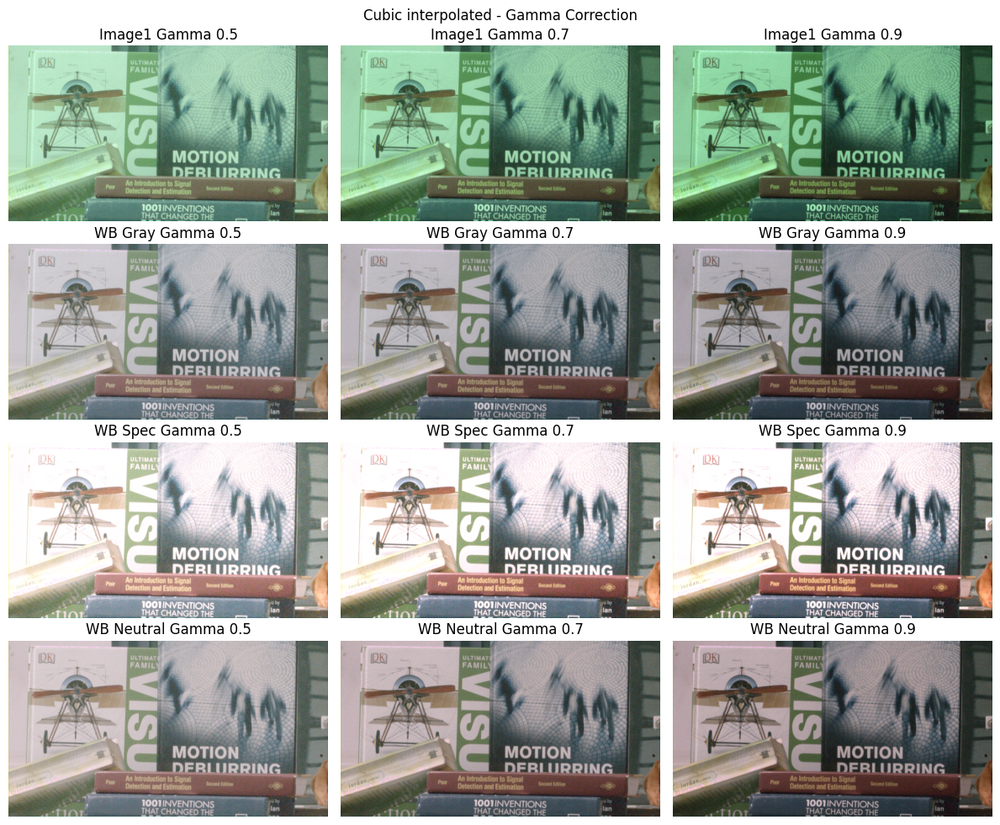

In [31]:
gamma_corrected_img1_cubic = [[gamma_correction(img1_cubic, 0.5), gamma_correction(img1_cubic, 0.7), gamma_correction(img1_cubic, 0.9)],
    [gamma_correction(wb_img1_gray_cubic, 0.5), gamma_correction(wb_img1_gray_cubic, 0.7), gamma_correction(wb_img1_gray_cubic, 0.9)],
    [gamma_correction(wb_img1_spec_cubic, 0.5), gamma_correction(wb_img1_spec_cubic, 0.7), gamma_correction(wb_img1_spec_cubic, 0.9)],
    [gamma_correction(wb_img1_neut_cubic, 0.5), gamma_correction(wb_img1_neut_cubic, 0.7), gamma_correction(wb_img1_neut_cubic, 0.9)]]
plot_gamma_corrected_imgs(gamma_corrected_img1_cubic, gamma_values, titles, "Cubic")

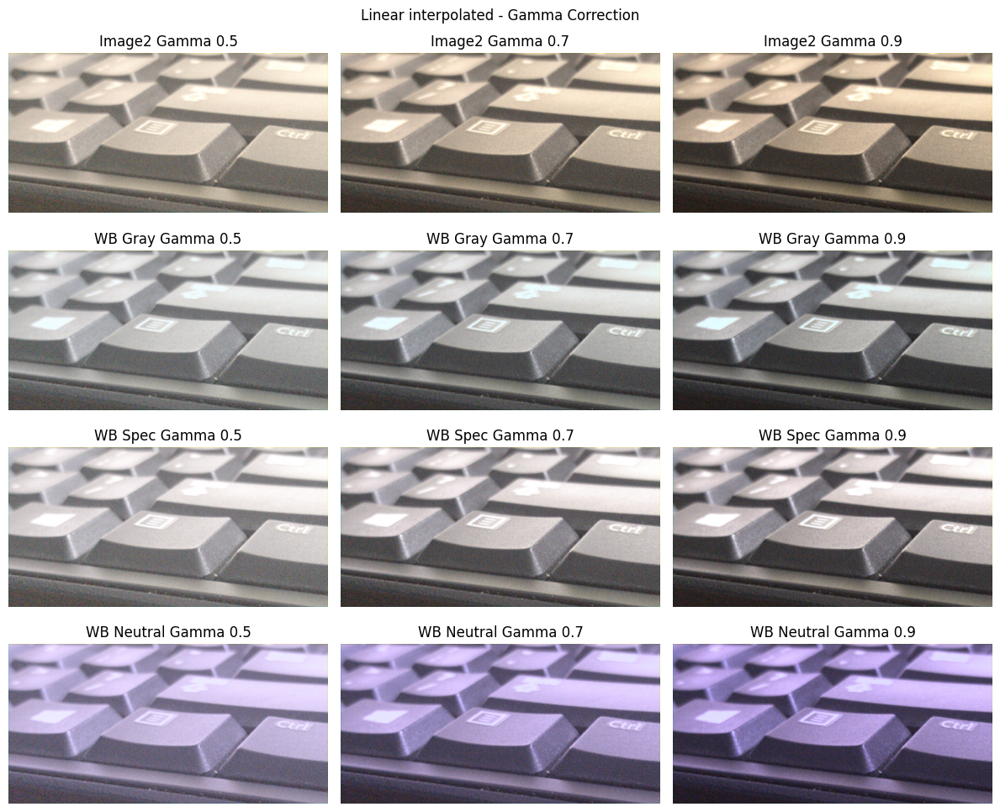

In [32]:
gamma_corrected_img2_linear = [[gamma_correction(img2_linear, 0.5), gamma_correction(img2_linear, 0.7), gamma_correction(img2_linear, 0.9)],
    [gamma_correction(wb_img2_gray_linear, 0.5), gamma_correction(wb_img2_gray_linear, 0.7), gamma_correction(wb_img2_gray_linear, 0.9)],
    [gamma_correction(wb_img2_spec_linear, 0.5), gamma_correction(wb_img2_spec_linear, 0.7), gamma_correction(wb_img2_spec_linear, 0.9)],
    [gamma_correction(wb_img2_neut_linear, 0.5), gamma_correction(wb_img2_neut_linear, 0.7), gamma_correction(wb_img2_neut_linear, 0.9)]]

titles = ["Image2", "WB Gray", "WB Spec", "WB Neutral"]
plot_gamma_corrected_imgs(gamma_corrected_img2_linear, gamma_values, titles, "Linear")

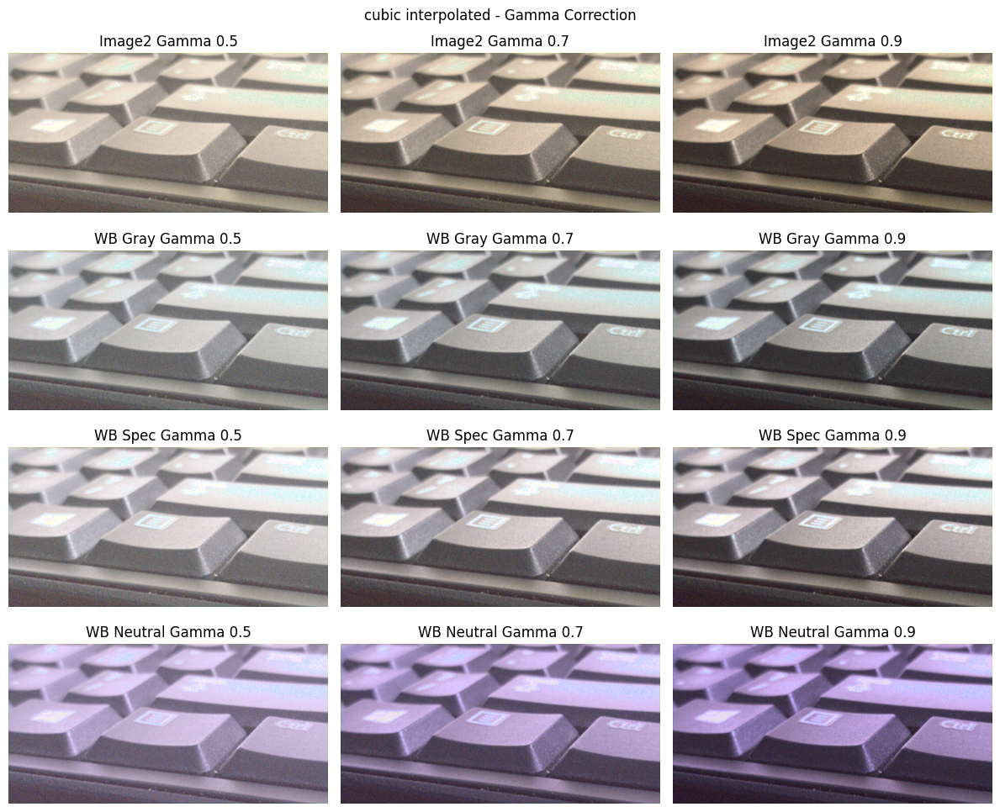

In [33]:
gamma_corrected_img2_cubic = [[gamma_correction(img2_cubic, 0.5), gamma_correction(img2_cubic, 0.7), gamma_correction(img2_cubic, 0.9)],
    [gamma_correction(wb_img2_gray_cubic, 0.5), gamma_correction(wb_img2_gray_cubic, 0.7), gamma_correction(wb_img2_gray_cubic, 0.9)],
    [gamma_correction(wb_img2_spec_cubic, 0.5), gamma_correction(wb_img2_spec_cubic, 0.7), gamma_correction(wb_img2_spec_cubic, 0.9)],
    [gamma_correction(wb_img2_neut_cubic, 0.5), gamma_correction(wb_img2_neut_cubic, 0.7), gamma_correction(wb_img2_neut_cubic, 0.9)]]

titles = ["Image2", "WB Gray", "WB Spec", "WB Neutral"]
plot_gamma_corrected_imgs(gamma_corrected_img2_cubic, gamma_values, titles, "cubic")

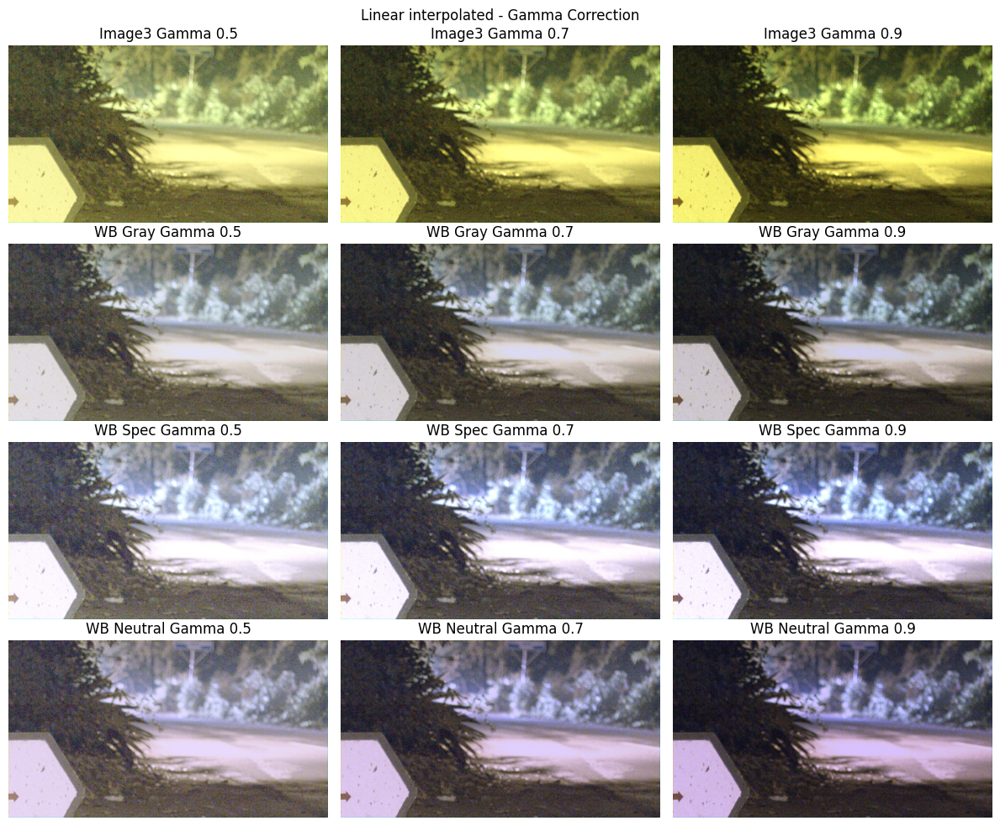

In [34]:
gamma_corrected_img3_linear = [[gamma_correction(img3_linear, 0.5), gamma_correction(img3_linear, 0.7), gamma_correction(img3_linear, 0.9)],
    [gamma_correction(wb_img3_gray_linear, 0.5), gamma_correction(wb_img3_gray_linear, 0.7), gamma_correction(wb_img3_gray_linear, 0.9)],
    [gamma_correction(wb_img3_spec_linear, 0.5), gamma_correction(wb_img3_spec_linear, 0.7), gamma_correction(wb_img3_spec_linear, 0.9)],
    [gamma_correction(wb_img3_neut_linear, 0.5), gamma_correction(wb_img3_neut_linear, 0.7), gamma_correction(wb_img3_neut_linear, 0.9)]]

titles = ["Image3", "WB Gray", "WB Spec", "WB Neutral"]
plot_gamma_corrected_imgs(gamma_corrected_img3_linear, gamma_values, titles, "Linear")

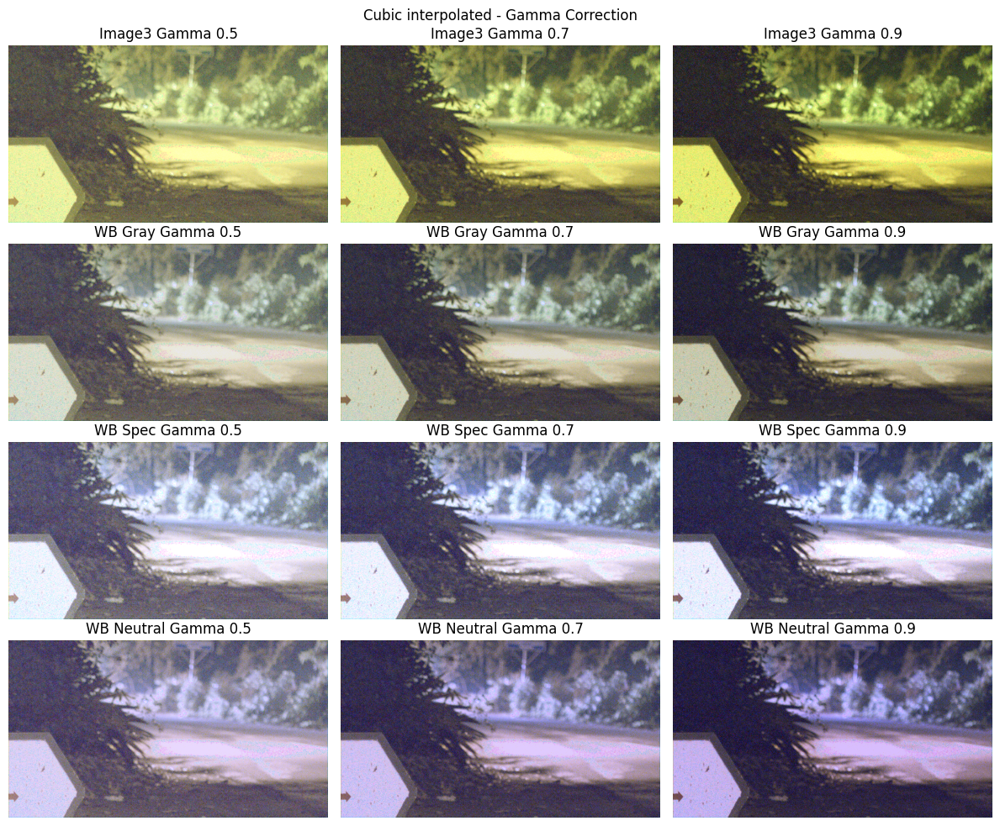

In [35]:
gamma_corrected_img3_cubic = [[gamma_correction(img3_cubic, 0.5), gamma_correction(img3_cubic, 0.7), gamma_correction(img3_cubic, 0.9)],
    [gamma_correction(wb_img3_gray_cubic, 0.5), gamma_correction(wb_img3_gray_cubic, 0.7), gamma_correction(wb_img3_gray_cubic, 0.9)],
    [gamma_correction(wb_img3_spec_cubic, 0.5), gamma_correction(wb_img3_spec_cubic, 0.7), gamma_correction(wb_img3_spec_cubic, 0.9)],
    [gamma_correction(wb_img3_neut_cubic, 0.5), gamma_correction(wb_img3_neut_cubic, 0.7), gamma_correction(wb_img3_neut_cubic, 0.9)]]

titles = ["Image3", "WB Gray", "WB Spec", "WB Neutral"]
plot_gamma_corrected_imgs(gamma_corrected_img3_cubic, gamma_values, titles, "Cubic")

**4) Denoising**

In [36]:
# I am chosing the cubic interpolated + wb gray + gamma 0.7 images for denoising as all the above results with this combination looks 
patch1 = wb_img1_gray_cubic[770:830, 980:1040,:]
patch2 = wb_img2_gray_cubic[924:984, 705:765,:]
patch3 = wb_img3_gray_cubic[1050:1110, 10:70,:]

sigma_n1 = np.std(patch1, axis=(0,1))
sigma_n2 = np.std(patch2, axis=(0,1))
sigma_n3 = np.std(patch3, axis=(0,1))

sigma_s = 2.5
sigma_r1 = 1.95 * sigma_n1
sigma_r2 = 1.95 * sigma_n2
sigma_r3 = 1.95 * sigma_n3

print(f"sigma_r1: {sigma_r1}")
print(f"sigma_r2: {sigma_r2}")
print(f"sigma_r3: {sigma_r3}")

sigma_r1: [51.25238212 15.78908045 30.88751834]
sigma_r2: [57.7957226  31.28394666 49.48117354]
sigma_r3: [119.03013647  66.03980556  43.83944985]


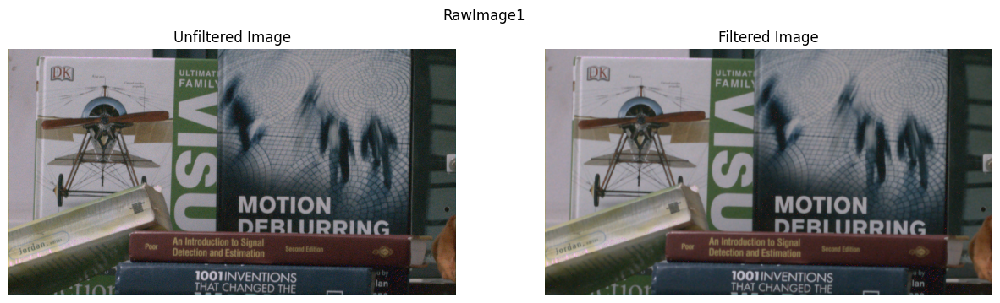

In [37]:
denoised_channels_img1 = []
for i in range(3):  # Loop over R, G, B channels
    # Apply bilateral filter to each channel
    denoised_channel = cv2.bilateralFilter(wb_img1_gray_cubic[:,:,i], d=11, sigmaColor=sigma_r1[i], sigmaSpace=sigma_s)
    denoised_channels_img1.append(denoised_channel)
denoised_img1 = np.stack(denoised_channels_img1, axis=-1)

plt.figure(figsize=(15,4))
plt.subplot(121),plt.imshow(wb_img1_gray_cubic), plt.title("Unfiltered Image"), plt.axis("off")
plt.subplot(122),plt.imshow(denoised_img1), plt.title("Filtered Image"), plt.axis("off")
plt.suptitle("RawImage1")
plt.show()

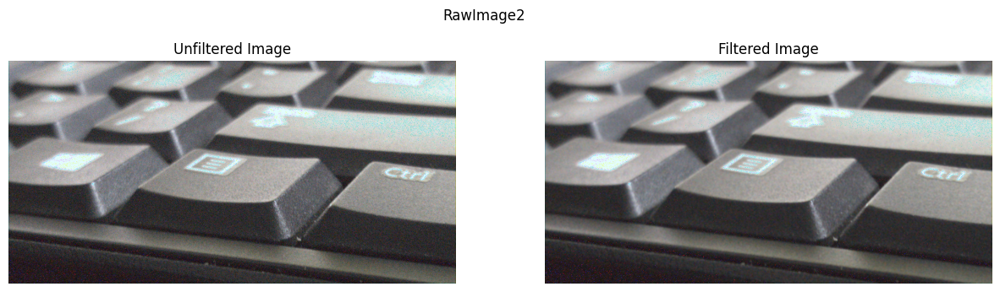

In [38]:
denoised_channels_img2 = []
for i in range(3):  # Loop over R, G, B channels
    # Apply bilateral filter to each channel
    denoised_channel = cv2.bilateralFilter(wb_img2_gray_cubic[:,:,i], d=11, sigmaColor=sigma_r2[i], sigmaSpace=sigma_s)
    denoised_channels_img2.append(denoised_channel)
denoised_img2 = np.stack(denoised_channels_img2, axis=-1)

plt.figure(figsize=(15,4))
plt.subplot(121),plt.imshow(wb_img2_gray_cubic), plt.title("Unfiltered Image"), plt.axis("off")
plt.subplot(122),plt.imshow(denoised_img2), plt.title("Filtered Image"), plt.axis("off")
plt.suptitle("RawImage2")
plt.show()

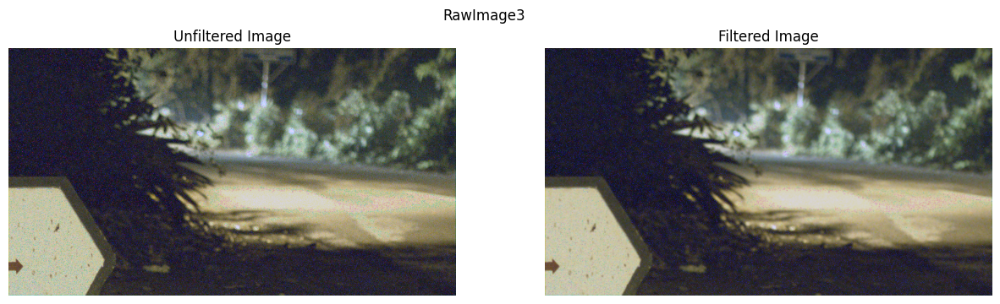

In [39]:
denoised_channels_img3 = []
for i in range(3):  # Loop over R, G, B channels
    # Apply bilateral filter to each channel
    denoised_channel = cv2.bilateralFilter(wb_img3_gray_cubic[:,:,i], d=11, sigmaColor=sigma_r3[i], sigmaSpace=sigma_s)
    denoised_channels_img3.append(denoised_channel)
denoised_img3 = np.stack(denoised_channels_img3, axis=-1)

plt.figure(figsize=(15,4))
plt.subplot(121),plt.imshow(wb_img3_gray_cubic), plt.title("Unfiltered Image"), plt.axis("off")
plt.subplot(122),plt.imshow(denoised_img3), plt.title("Filtered Image"), plt.axis("off")
plt.suptitle("RawImage3")
plt.show()

**4.1.1)** The Gaussian function has infinite support, meaning it extends from − inf to +inf  and never reaches zero, though its values decrease as you move away from the mean. The standard deviation (sigma) controls the spread of the values around the mean, with values closer to the mean being larger and those farther away becoming smaller. For a Gaussian curve, 1σ covers about 68% of the distribution, while 3 sigma covers 99.7%, making it a practical truncation point. At 3 sigma, the Gaussian value is less than 0.01 of its peak, meaning that beyond this point, contributions are negligible. Truncating the function at 3 sigma ensures that 99.7% of the distribution is captured, balancing computational efficiency with accuracy. This makes 3 sigma a common choice in implementations, as it minimizes unnecessary calculations while maintaining the integrity of the filter.

**4.1.2)** If sigma_r​ is too small, the filter becomes very sensitive to small intensity differences, which can result in over-smoothing and loss of important details. If sigma_r​ is too large, intensity differences become less important, and the filter behaves more like a traditional Gaussian filter. This means that the filter may fail to preserve edges and could blur them, reducing the effectiveness of edge-preserving denoising

**5) Depth of field**


In [49]:
# Function to compute hyperfocal distance
def hyperfocal(f, N, coc):
    return (f ** 2) / (N * coc) + f

def D_near(H, D, f):
    return (H * D) / (H + (D - f))

def D_far(H, D, f):
    return (H * D) / (H - (D - f))

In [51]:
focal_len = 16 # mm
coc = 0.00345 * 3 # mm

apertures = [2.2, 4, 4] 
dfs = [3000,3000,1000] # mm

for N, df in zip(apertures, dfs):
    H = hyperfocal(focal_len, N, coc)
    dist_near = D_near(H, df, focal_len)
    dist_far = D_far(H, df, focal_len)
    dof = dist_far - dist_near 

    print(f"Aperture: {N}, Focal Distance: {df/1000:.2f} m, DOF-: {dist_far:.2f}, DOF+: {dist_near:.2f}, Depth of Field: {dof/1000:.2f} m")

Aperture: 2.2, Focal Distance: 3.00 m, DOF-: 4081.83, DOF+: 2371.47, Depth of Field: 1.71 m
Aperture: 4, Focal Distance: 3.00 m, DOF-: 5783.95, DOF+: 2025.22, Depth of Field: 3.76 m
Aperture: 4, Focal Distance: 1.00 m, DOF-: 1188.67, DOF+: 863.02, Depth of Field: 0.33 m


**5b**
1. The DOF increases as the aperture size decreases (e.g., from f/2.2 to f/4), while keeping the focus distance constant.

2. When the aperture is fixed, the DOF is larger when the focus distance is greater (e.g., 3m), compared to when the camera is focused on closer objects.

3. The objects behind the focal distance are more focused than the object infront of the focal distance